In [1]:
!pip install imageio
!pip install git+https://github.com/tensorflow/docs

import PIL, os, numpy as np, sys, cv2, zipfile, pandas as pd, tensorflow as tf, glob, imageio, time, tensorflow_docs.vis.embed as embed
from matplotlib import pyplot as plt
from tensorflow.keras import layers
from keras.utils import np_utils
from sklearn.model_selection import train_test_split
from google.colab import drive
from IPython import display
drive.mount("/content/gdrive")
#tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-jznntw5j
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-jznntw5j
  Resolved https://github.com/tensorflow/docs to commit e4ab8e01220062d0351ff63bd98486c6a82be2b5
  Preparing metadata (setup.py) ... done
Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!cp "/content/gdrive/MyDrive/PUC/TCC/Notebooks/preTreinados/kaggle.json" "."
!chmod 600 kaggle.json
!rm -r ~/.kaggle
!mkdir ~/.kaggle
!mv ./kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d kmader/skin-cancer-mnist-ham10000
with zipfile.ZipFile("/content/skin-cancer-mnist-ham10000.zip", 'r') as zip_ref:
    zip_ref.extractall(".")
del zip_ref
!mv /content/HAM10000_images_part_1/*.jpg /content/HAM10000_images_part_2

rm: cannot remove '/root/.kaggle': No such file or directory
100% 5.20G/5.20G [04:07<00:00, 23.1MB/s]
100% 5.20G/5.20G [04:07<00:00, 22.6MB/s]


In [2]:
datasetMetadata = pd.read_csv("/content/HAM10000_metadata.csv")
datasetMetadata = datasetMetadata.drop(columns=['dx_type','age','sex','localization']) # Non-utilized columns
datasetMetadata = datasetMetadata.rename(columns={"lesion_id": "lesionId",
                                                  "image_id": "imageId",
                                                  "dx": "cancerId"})
datasetMetadata['duplicate'] = datasetMetadata['lesionId']      # Creating a column to indicate if the lesion has more than one image

uniqueLesions = datasetMetadata.groupby('lesionId').count()     # Counts the number of lesions for each id
uniqueLesions = uniqueLesions[uniqueLesions['imageId'] == 1]    # Filter lesions which ones have unique id
uniqueLesions.reset_index(inplace = True)                       # Add default index column
uniqueLesions = uniqueLesions['lesionId'].values.tolist()       # Extracts the indexes into a list

datasetMetadata['duplicate'] = datasetMetadata['lesionId'].apply(lambda x: False if x in uniqueLesions else True) # Fill the rows indicating if the lesion has a duplicated image

del uniqueLesions
datasetMetadata = datasetMetadata[~((datasetMetadata['lesionId'].duplicated()) & (datasetMetadata['duplicate']))]
cancerType = {
    'akiec': 0, # 0.0 - 'Doenca de Bowens'
    'bcc':   1, # 1.0 - 'Carcinoma basocelular'
    'bkl':   2, # 2.0 - 'Keratose benigna'
    'df':    3, # 3.0 - 'Dermatofibroma'
    'vasc':  4, # 4.0 - 'Lesao vascular'
    'mel':   5, # 5.0 - 'Melanoma'
    'nv':    6  # 6.0 - 'Nevo melanocitico'
}
num_classes = len(cancerType)

In [27]:
images = []

for index, row in datasetMetadata.iterrows():
    if row['cancerId'] == 'mel':
      img = cv2.imread(''.join(['/content/HAM10000_images_part_2/', row['imageId'], '.jpg']))
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Invert color BGR => RGB
      img = cv2.resize(img, (256, 256))          # Resize the image according to params provided
      #img = (img - 127.5) / 127.5                # Normalize image to generator recognize values [-1,1]
      mean = np.mean(img)
      std = np.std(img)
      img = (img - mean) / std
      images.append(img)

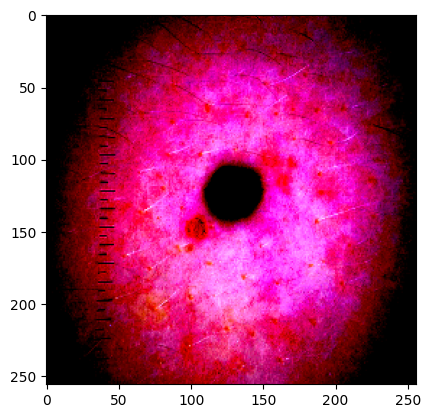

In [28]:
plt.imshow(images[0])
plt.show()

In [40]:
batch = 5

melanomaTraining = tf.data.Dataset.from_tensor_slices(images).batch(batch)

In [41]:
def generatorModel():
#   model = tf.keras.Sequential()
#   model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Reshape((8, 8, 256)))
#   assert model.output_shape == (None, 8, 8, 256)  # Note: None is the batch size

#   model.add(layers.Conv2DTranspose(256, (5, 5), strides=(1, 1), padding='same', use_bias=False))
#   assert model.output_shape == (None, 8, 8, 256)
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
#   assert model.output_shape == (None, 8, 8, 128)
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#   assert model.output_shape == (None, 16, 16, 64)
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Conv2DTranspose(32, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#   assert model.output_shape == (None, 32, 32, 32)
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Conv2DTranspose(16, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#   assert model.output_shape == (None, 64, 64, 16)
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Conv2DTranspose(8, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#   assert model.output_shape == (None, 128, 128, 8)
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh')) # Last layer need to have the tanh activation
#   assert model.output_shape == (None, 256, 256, 3)
    model = tf.keras.Sequential([

        tf.keras.layers.Conv2DTranspose(256, kernel_size=4, strides=1, padding='valid', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.ReLU(),

        tf.keras.layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.ReLU(),

        tf.keras.layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.ReLU(),

        tf.keras.layers.Conv2DTranspose(32, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.ReLU(),

        tf.keras.layers.Conv2DTranspose(16, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.ReLU(),

        tf.keras.layers.Conv2DTranspose(8, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.ReLU(),

        tf.keras.layers.Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.Activation('tanh')
    ])

    return model

def discriminatorModel():
#   model = tf.keras.Sequential()
#   model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[256, 256, 3]))
#   model.add(layers.LeakyReLU())
#   model.add(layers.Dropout(0.3))

#   model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
#   model.add(layers.LeakyReLU())
#   model.add(layers.Dropout(0.3))

#   model.add(layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
#   model.add(layers.LeakyReLU())
#   model.add(layers.Dropout(0.3))

#   model.add(layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'))
#   model.add(layers.LeakyReLU())
#   model.add(layers.Dropout(0.3))

#   model.add(layers.Flatten())
#   model.add(layers.Dense(1))
    model = tf.keras.Sequential([

        tf.keras.layers.Conv2D(16, kernel_size=4, strides=2, padding='same', use_bias=False, input_shape=(256, 256, 3)),
        tf.keras.layers.LeakyReLU(0.2),

        tf.keras.layers.Conv2D(32, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.LeakyReLU(0.2),

        tf.keras.layers.Conv2D(64, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.LeakyReLU(0.2),

        tf.keras.layers.Conv2D(128, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.LeakyReLU(0.2),

        tf.keras.layers.Conv2D(256, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.LeakyReLU(0.2),

        tf.keras.layers.Conv2D(512, kernel_size=4, strides=2, padding='same', use_bias=False),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.LeakyReLU(0.2),

        tf.keras.layers.Conv2D(1, kernel_size=4, strides=1, padding='valid', use_bias=False),
        tf.keras.layers.Activation('sigmoid')
    ])
    return model
genModel = generatorModel()
discModel = discriminatorModel()

In [42]:
# This method returns a helper function to compute cross entropy loss
crossEntropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)


def discriminatorLoss(realOutput, fakeOutput):
    realLoss = crossEntropy(tf.ones_like(realOutput), realOutput)
    fakeLoss = crossEntropy(tf.zeros_like(fakeOutput), fakeOutput)
    totalLoss = realLoss + fakeLoss
    return totalLoss

def generatorLoss(fakeOutput):
    #mse_loss = tf.keras.losses.MeanSquaredError()
    #return mse_loss(target_images, fake_output)
    return crossEntropy(tf.ones_like(fakeOutput), fakeOutput)

generatorOptimizer = tf.keras.optimizers.Adam(1e-4)
discriminatorOptimizer = tf.keras.optimizers.Adam(1e-4)

In [43]:
checkpointDir = './training_checkpoints'
checkpointPrefix = os.path.join(checkpointDir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generatorOptimizer,
                                 discriminator_optimizer=discriminatorOptimizer,
                                 generator=genModel,
                                 discriminator=discModel)

In [44]:
epochs = 200
noiseDim = 100
examplesToGen = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([examplesToGen, 1, 1, noiseDim])

In [45]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    #noise = tf.random.normal([batch, noiseDim])
    #noise = tf.random.normal(shape=(2, 3, 1, 1), mean=0, stddev=1, dtype=tf.float32)
    noise = tf.random.normal(shape=(2, 1, 1, noiseDim))

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generatedImgs = genModel(noise, training=True)
      realOutput = discModel(images, training=True)
      fakeOutput = discModel(generatedImgs, training=True)

      genLoss = generatorLoss(fakeOutput)
      discLoss = discriminatorLoss(realOutput, fakeOutput)

    gradientsGenerator = gen_tape.gradient(genLoss, genModel.trainable_variables)
    gradientsDiscriminator = disc_tape.gradient(discLoss, discModel.trainable_variables)

    generatorOptimizer.apply_gradients(zip(gradientsGenerator, genModel.trainable_variables))
    discriminatorOptimizer.apply_gradients(zip(gradientsDiscriminator, discModel.trainable_variables))
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for img in dataset:
      train_step(img)

    # Save the model every 15 epochs
    #if (epoch + 1) % 15 == 0:
      # Produce images for the GIF as you go
    generate_and_save_images(genModel, epoch + 1, seed)
    checkpoint.save(file_prefix = checkpointPrefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time() - start))

  # Generate after the final epoch
  #generate_and_save_images(genModel,epochs,seed)
def generate_and_save_images(model, epoch, testInput):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(testInput, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i + 1)
      img = (predictions[i] + 1) / 2
      plt.imshow(img)
      #plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5)
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [46]:
test = os.listdir('.')
for item in test:
    if item.startswith("image_at_epoch_"):
        os.remove(item)

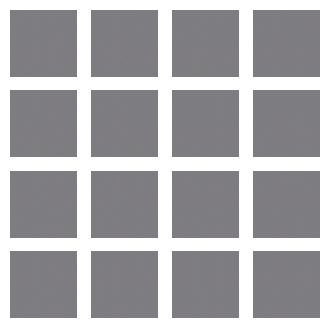

Time for epoch 1 is 10.658586740493774 sec


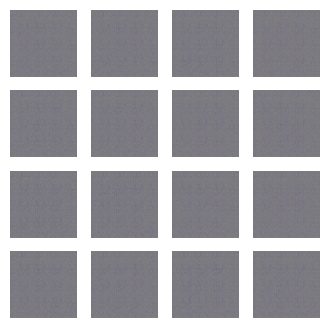

Time for epoch 2 is 2.1529009342193604 sec


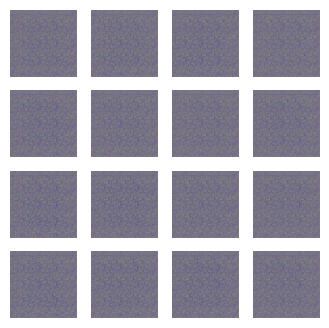

Time for epoch 3 is 2.1119916439056396 sec


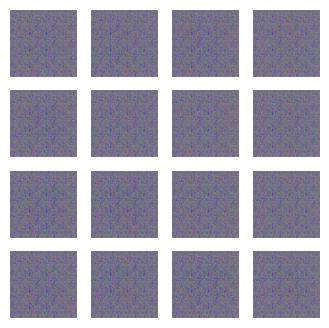

Time for epoch 4 is 2.1248345375061035 sec


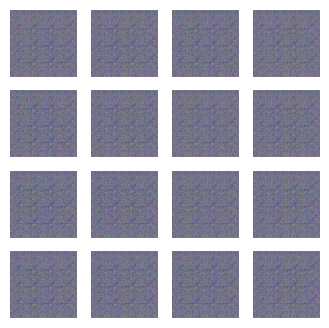

Time for epoch 5 is 2.1914806365966797 sec


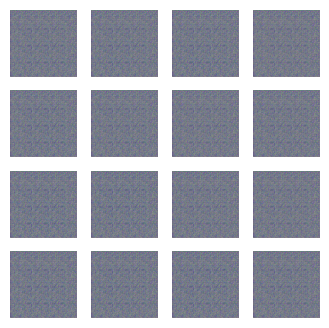

Time for epoch 6 is 2.461479663848877 sec


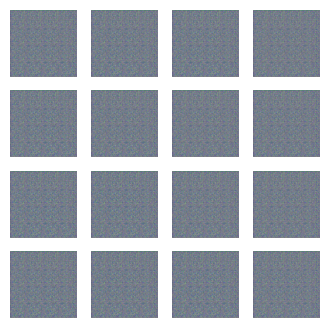

Time for epoch 7 is 2.094449520111084 sec


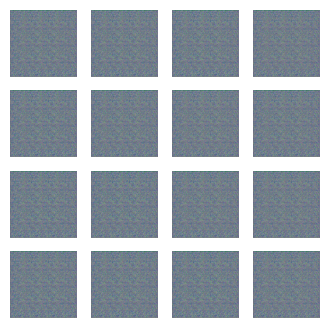

Time for epoch 8 is 2.089508295059204 sec


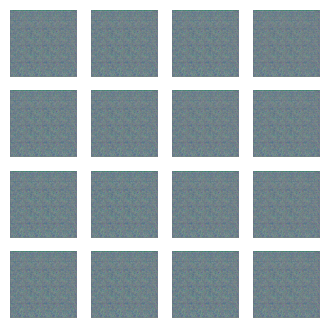

Time for epoch 9 is 2.136035442352295 sec


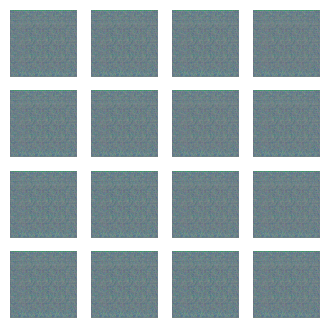

Time for epoch 10 is 2.1824018955230713 sec


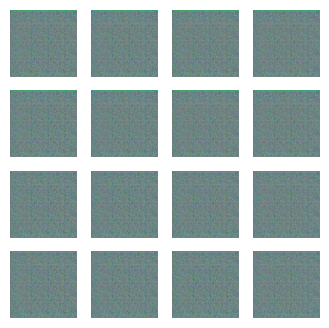

Time for epoch 11 is 2.631495714187622 sec


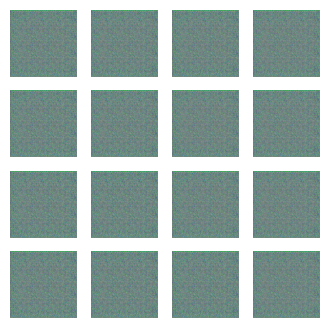

Time for epoch 12 is 2.124654769897461 sec


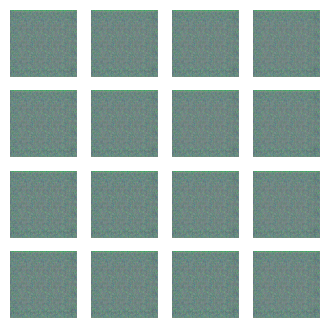

Time for epoch 13 is 2.108675718307495 sec


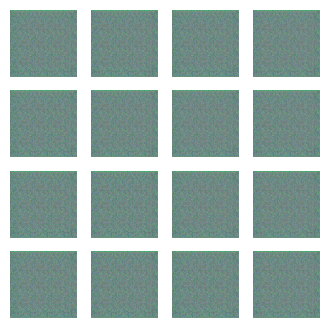

Time for epoch 14 is 2.1186561584472656 sec


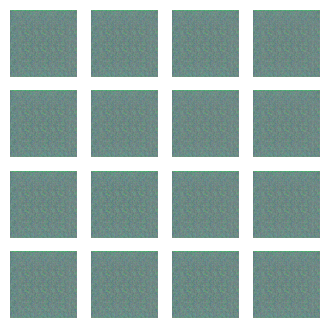

Time for epoch 15 is 2.1105856895446777 sec


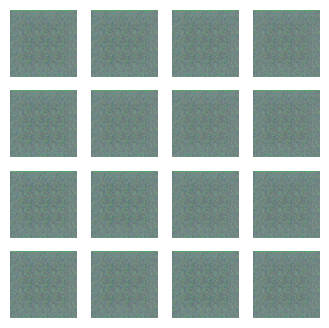

Time for epoch 16 is 2.6079812049865723 sec


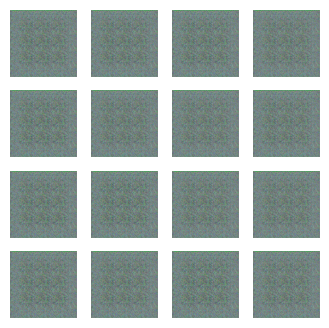

Time for epoch 17 is 2.0948543548583984 sec


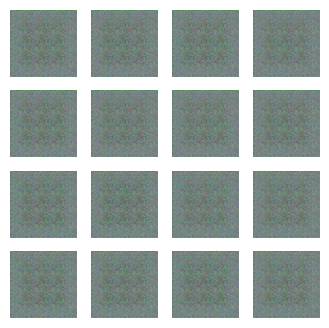

Time for epoch 18 is 2.104323387145996 sec


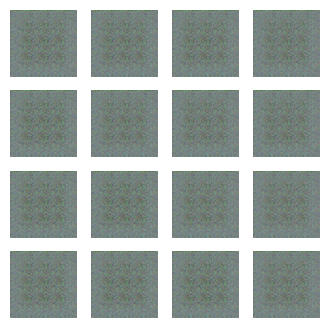

Time for epoch 19 is 2.10613751411438 sec


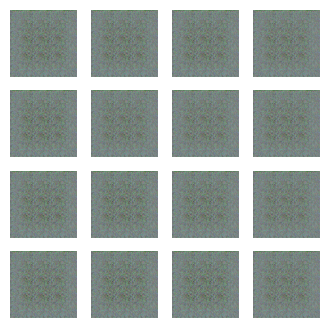

Time for epoch 20 is 2.059807062149048 sec


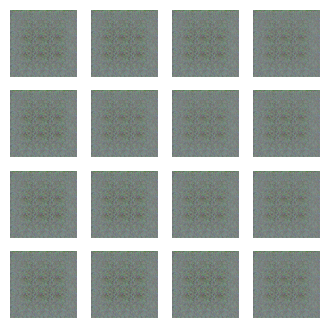

Time for epoch 21 is 2.127272129058838 sec


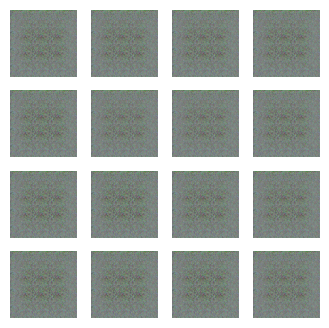

Time for epoch 22 is 2.540485143661499 sec


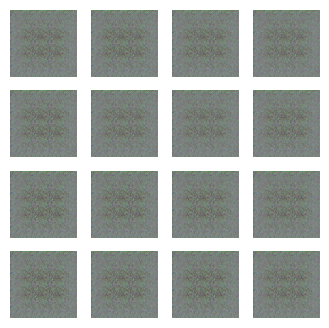

Time for epoch 23 is 2.133033275604248 sec


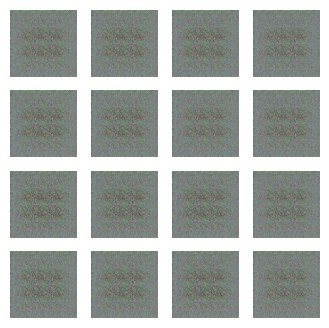

Time for epoch 24 is 2.0865869522094727 sec


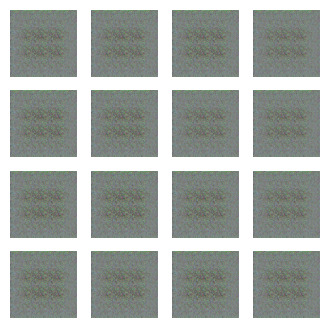

Time for epoch 25 is 2.211306571960449 sec


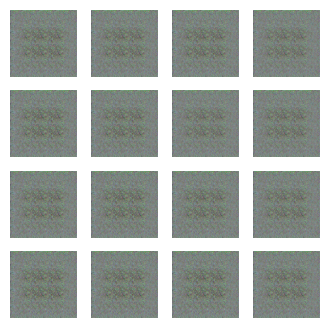

Time for epoch 26 is 2.44329833984375 sec


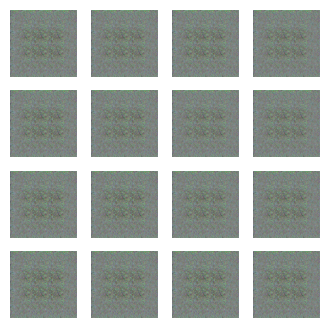

Time for epoch 27 is 2.166921854019165 sec


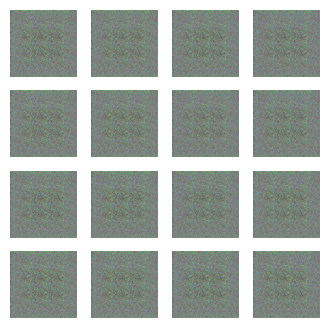

Time for epoch 28 is 2.140289068222046 sec


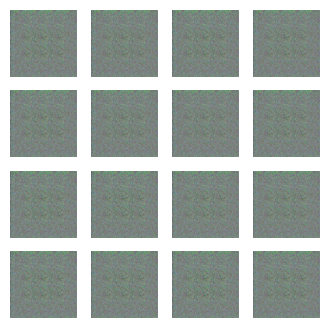

Time for epoch 29 is 2.1117002964019775 sec


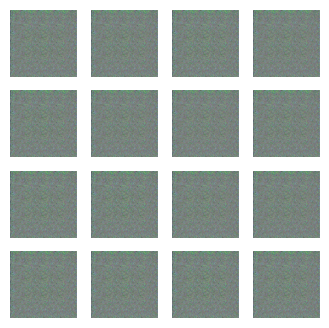

Time for epoch 30 is 2.0920090675354004 sec


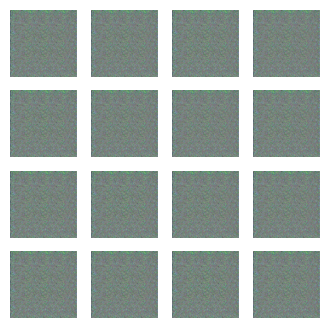

Time for epoch 31 is 2.665090799331665 sec


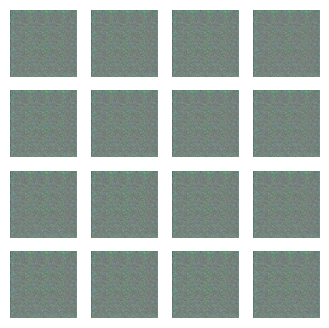

Time for epoch 32 is 2.143434524536133 sec


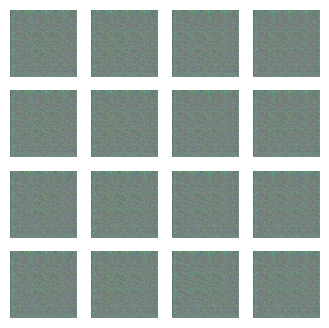

Time for epoch 33 is 2.17838454246521 sec


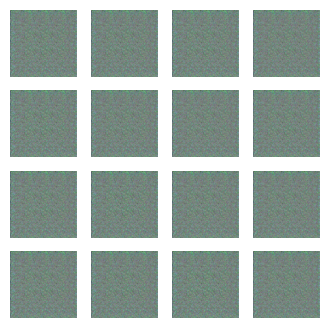

Time for epoch 34 is 2.124131202697754 sec


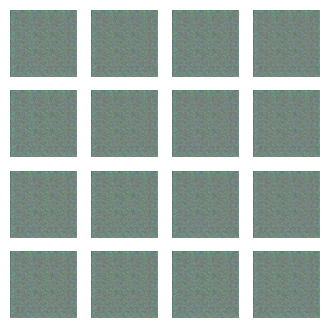

Time for epoch 35 is 2.1027631759643555 sec


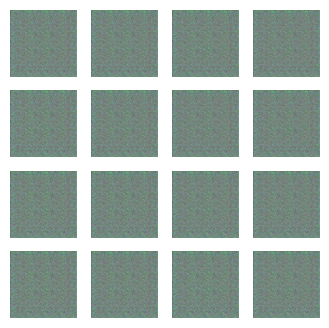

Time for epoch 36 is 2.400770902633667 sec


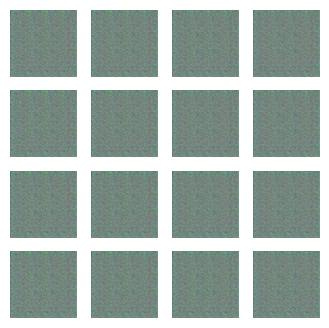

Time for epoch 37 is 2.1116976737976074 sec


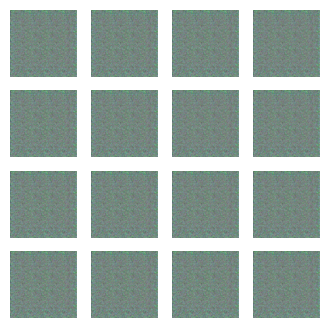

Time for epoch 38 is 2.1987464427948 sec


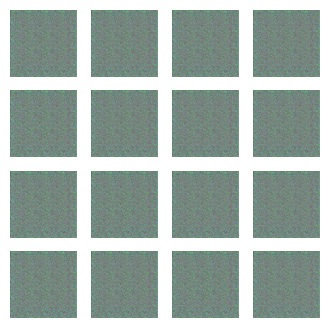

Time for epoch 39 is 2.224822521209717 sec


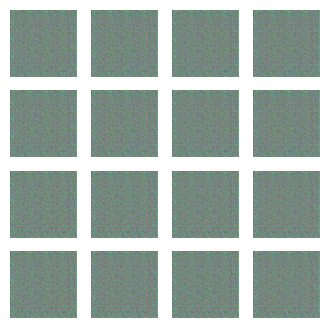

Time for epoch 40 is 2.120605707168579 sec


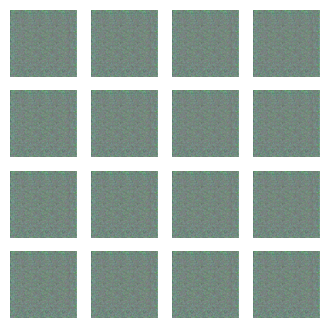

Time for epoch 41 is 2.433483839035034 sec


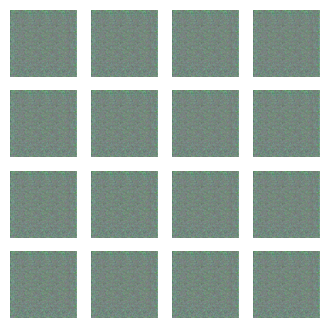

Time for epoch 42 is 2.145817995071411 sec


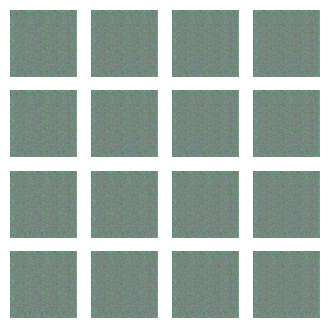

Time for epoch 43 is 2.12471079826355 sec


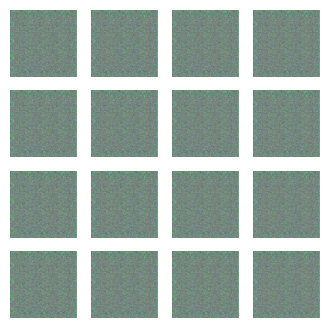

Time for epoch 44 is 2.1263177394866943 sec


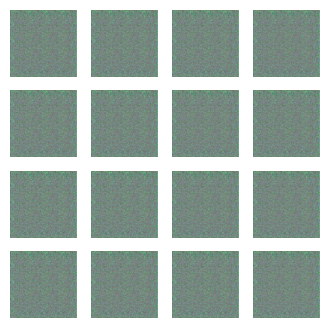

Time for epoch 45 is 2.118800163269043 sec


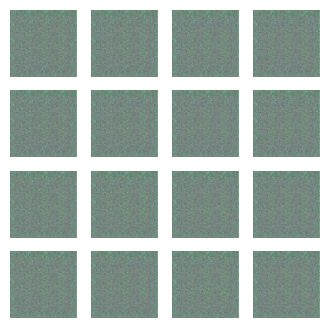

Time for epoch 46 is 2.442056179046631 sec


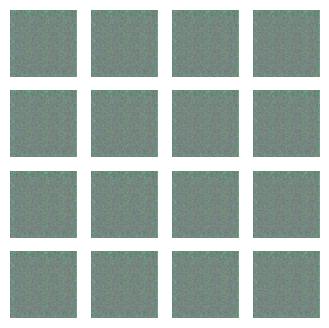

Time for epoch 47 is 2.1144118309020996 sec


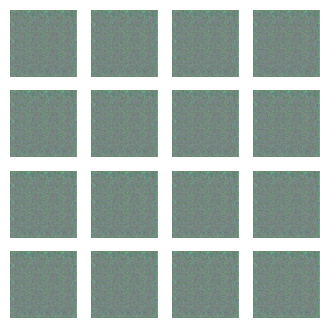

Time for epoch 48 is 2.1283445358276367 sec


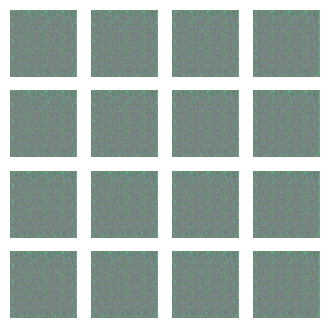

Time for epoch 49 is 2.118849754333496 sec


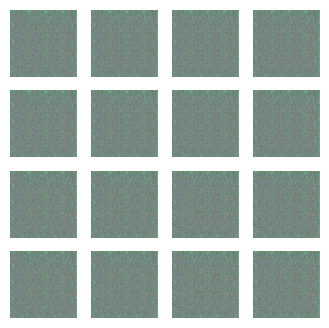

Time for epoch 50 is 2.1855461597442627 sec


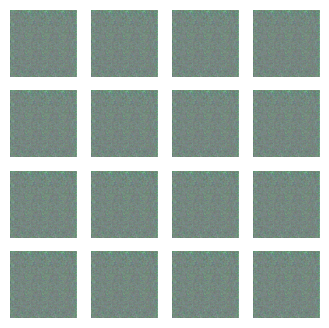

Time for epoch 51 is 2.418137550354004 sec


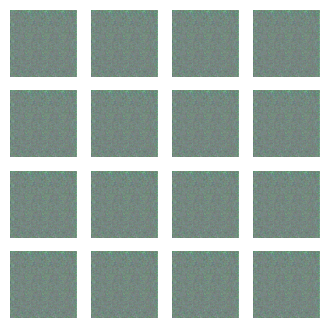

Time for epoch 52 is 2.114689826965332 sec


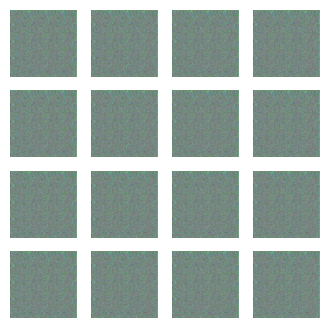

Time for epoch 53 is 2.150278091430664 sec


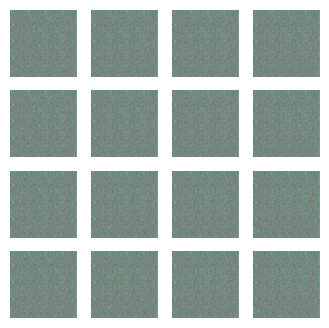

Time for epoch 54 is 2.1210880279541016 sec


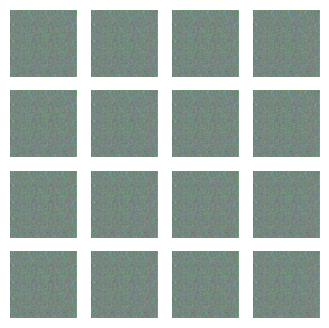

Time for epoch 55 is 2.140110492706299 sec


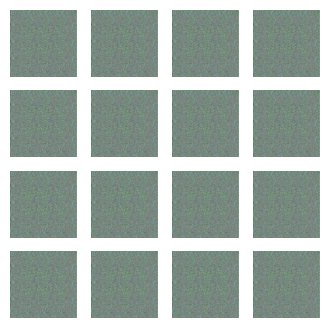

Time for epoch 56 is 2.506098508834839 sec


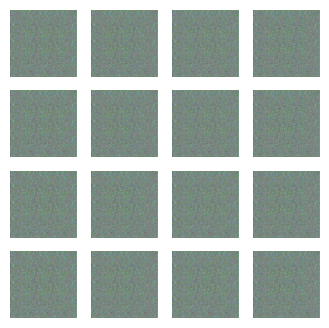

Time for epoch 57 is 2.1629796028137207 sec


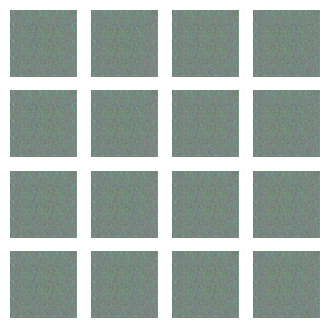

Time for epoch 58 is 2.1136133670806885 sec


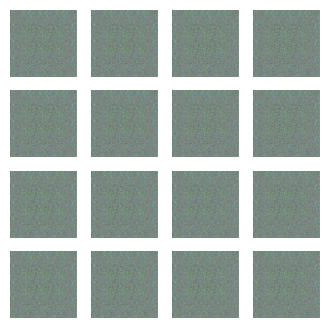

Time for epoch 59 is 2.1661813259124756 sec


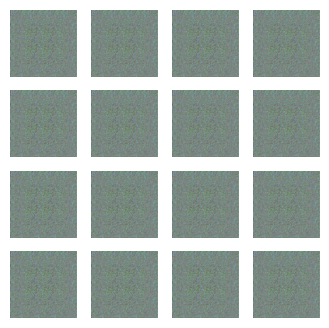

Time for epoch 60 is 2.1027419567108154 sec


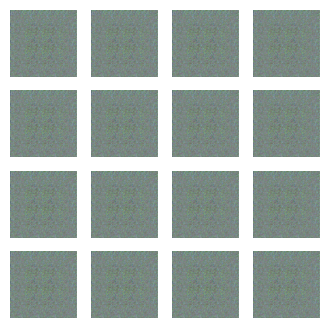

Time for epoch 61 is 2.6032636165618896 sec


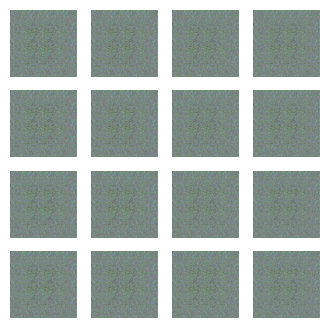

Time for epoch 62 is 2.1220178604125977 sec


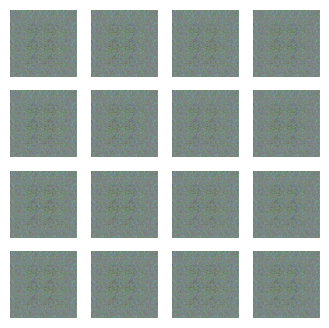

Time for epoch 63 is 2.126887798309326 sec


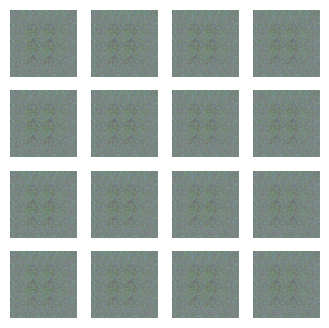

Time for epoch 64 is 2.173964262008667 sec


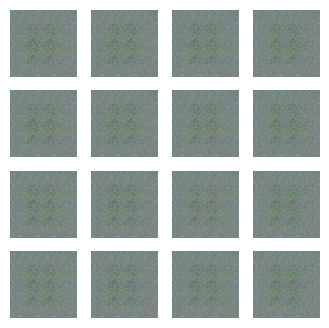

Time for epoch 65 is 2.209055185317993 sec


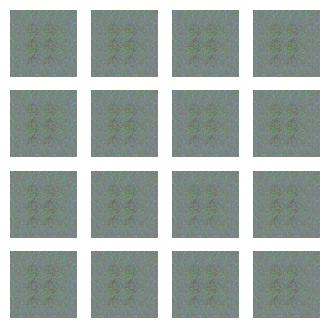

Time for epoch 66 is 2.4526474475860596 sec


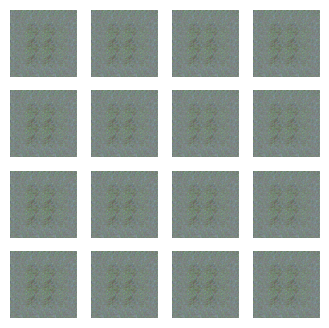

Time for epoch 67 is 2.133876085281372 sec


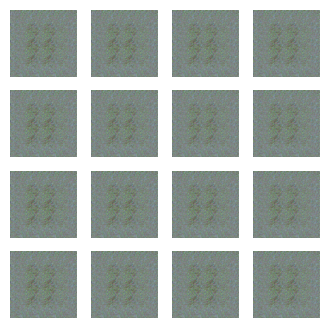

Time for epoch 68 is 2.1006460189819336 sec


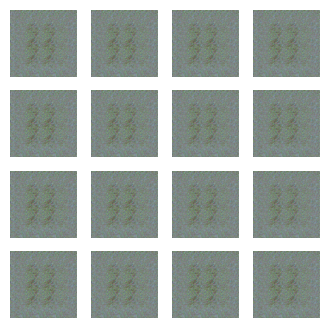

Time for epoch 69 is 2.1374356746673584 sec


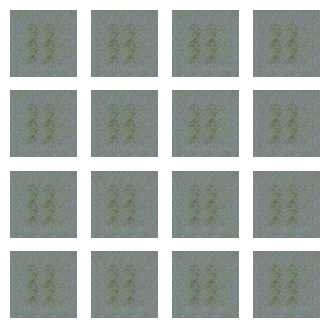

Time for epoch 70 is 2.117131471633911 sec


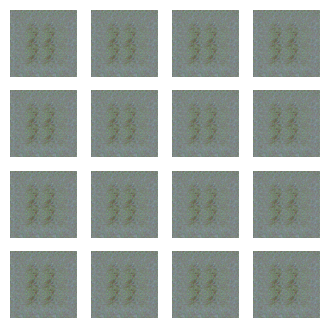

Time for epoch 71 is 2.502978801727295 sec


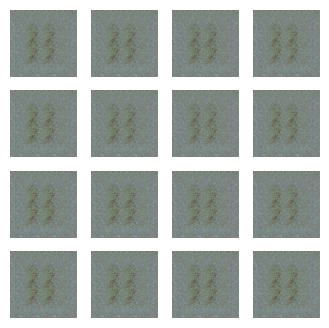

Time for epoch 72 is 2.1573500633239746 sec


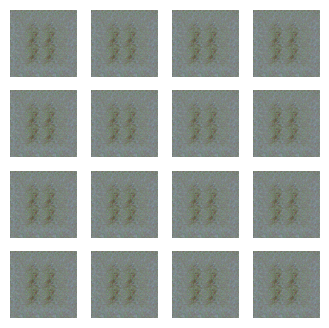

Time for epoch 73 is 2.1126627922058105 sec


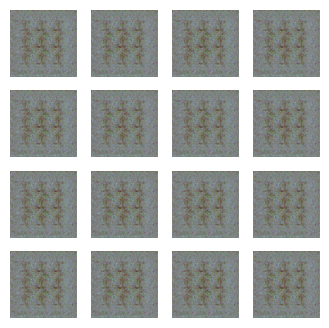

Time for epoch 74 is 2.091181993484497 sec


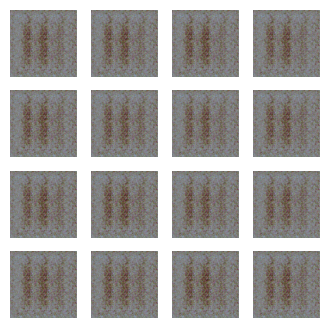

Time for epoch 75 is 2.1108171939849854 sec


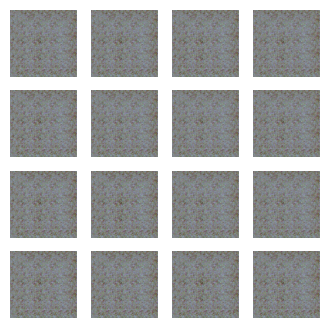

Time for epoch 76 is 2.4093990325927734 sec


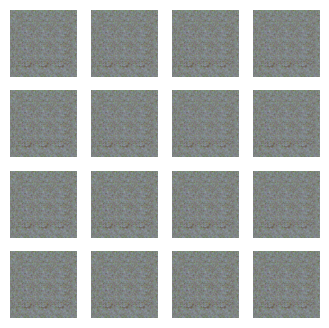

Time for epoch 77 is 2.181580066680908 sec


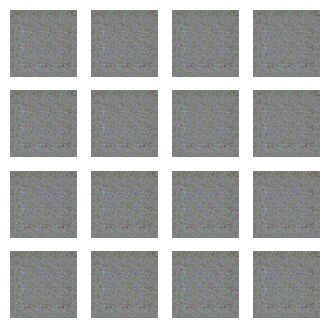

Time for epoch 78 is 2.2643516063690186 sec


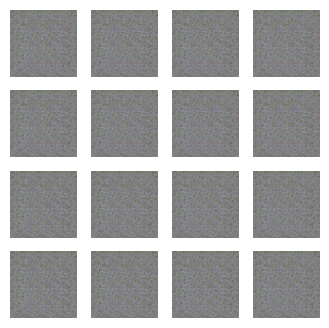

Time for epoch 79 is 2.154296875 sec


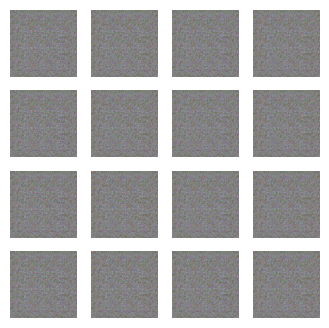

Time for epoch 80 is 2.1095287799835205 sec


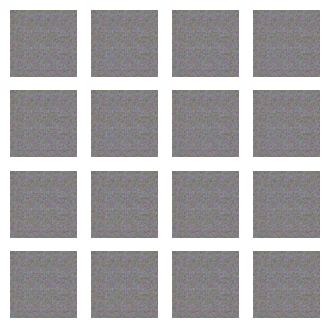

Time for epoch 81 is 2.460956335067749 sec


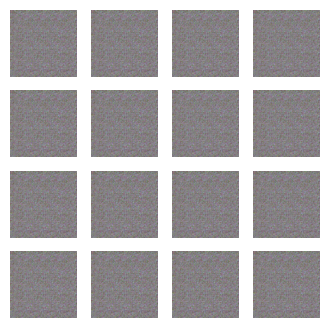

Time for epoch 82 is 2.1637349128723145 sec


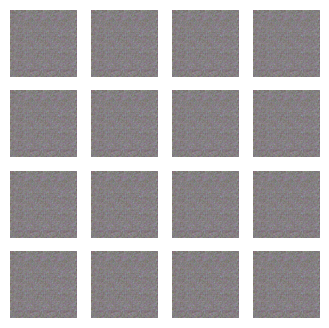

Time for epoch 83 is 2.1515214443206787 sec


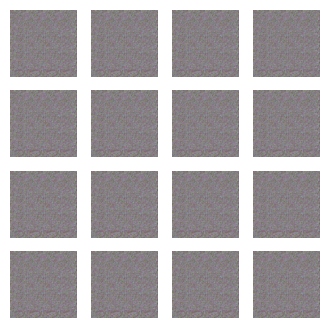

Time for epoch 84 is 2.1494133472442627 sec


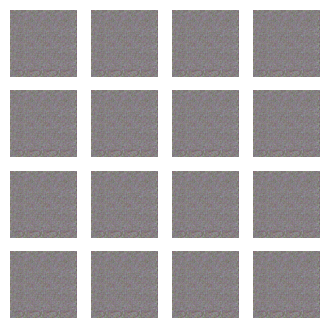

Time for epoch 85 is 2.122817277908325 sec


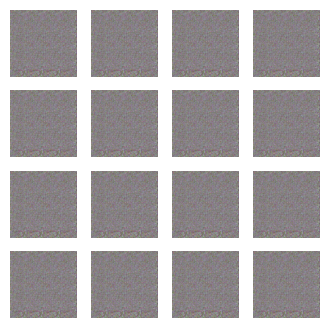

Time for epoch 86 is 2.4078893661499023 sec


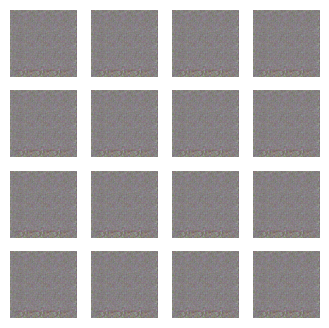

Time for epoch 87 is 2.0904128551483154 sec


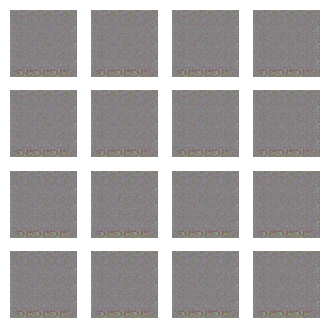

Time for epoch 88 is 2.1727821826934814 sec


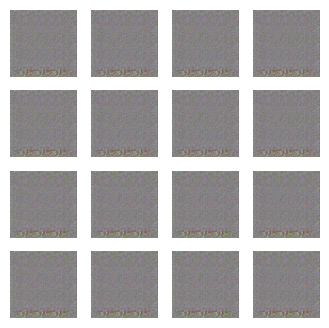

Time for epoch 89 is 2.106912851333618 sec


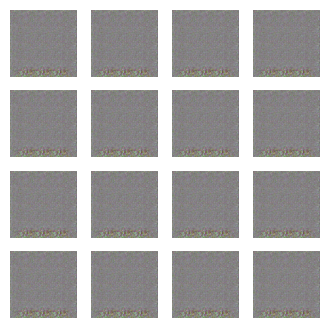

Time for epoch 90 is 2.4473257064819336 sec


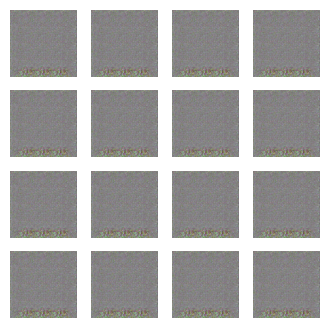

Time for epoch 91 is 2.313708782196045 sec


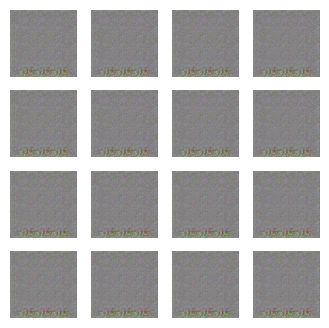

Time for epoch 92 is 2.130476951599121 sec


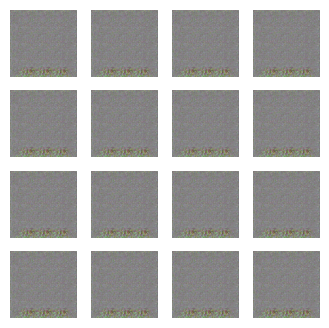

Time for epoch 93 is 2.127837657928467 sec


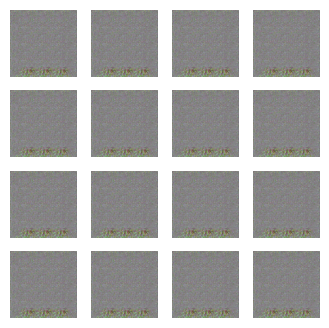

Time for epoch 94 is 2.1516880989074707 sec


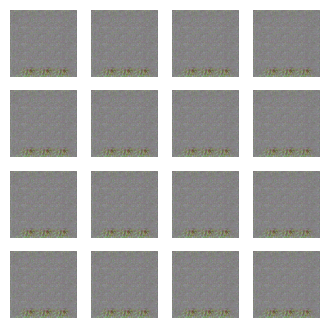

Time for epoch 95 is 2.2028112411499023 sec


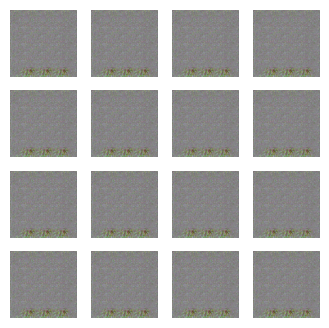

Time for epoch 96 is 2.4491639137268066 sec


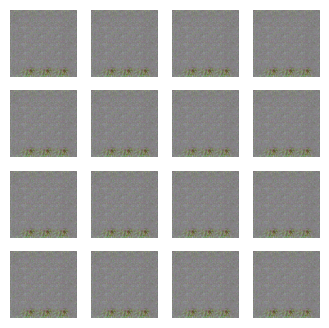

Time for epoch 97 is 2.10207200050354 sec


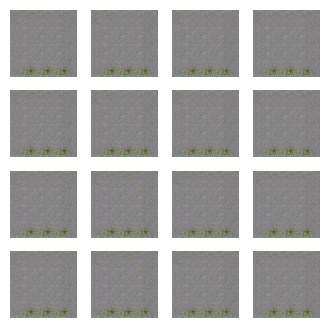

Time for epoch 98 is 2.139444589614868 sec


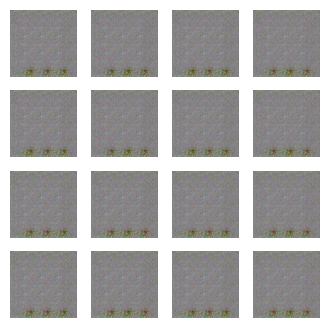

Time for epoch 99 is 2.0944695472717285 sec


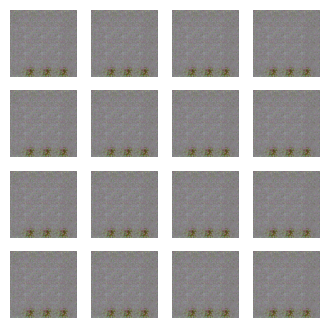

Time for epoch 100 is 2.6028997898101807 sec


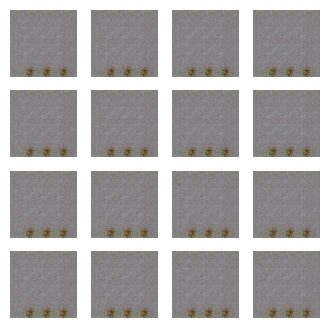

Time for epoch 101 is 2.2539286613464355 sec


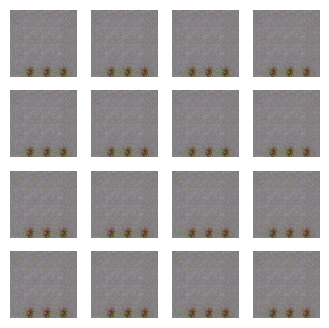

Time for epoch 102 is 2.2523202896118164 sec


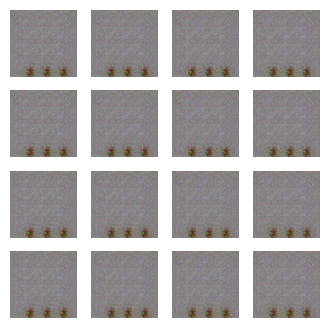

Time for epoch 103 is 2.111583709716797 sec


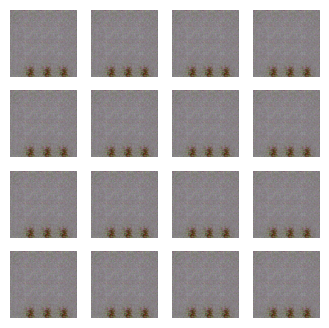

Time for epoch 104 is 2.1676928997039795 sec


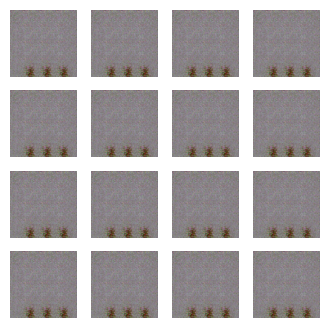

Time for epoch 105 is 2.457487106323242 sec


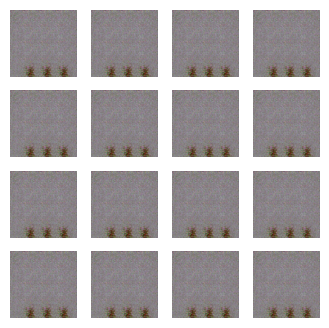

Time for epoch 106 is 2.169084072113037 sec


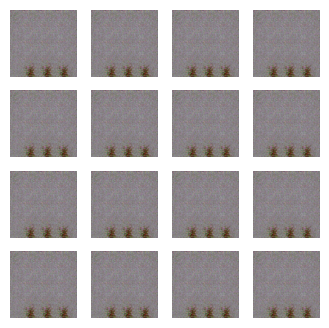

Time for epoch 107 is 2.19968581199646 sec


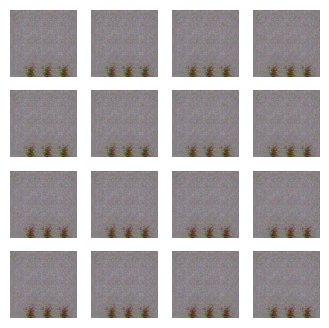

Time for epoch 108 is 2.1474363803863525 sec


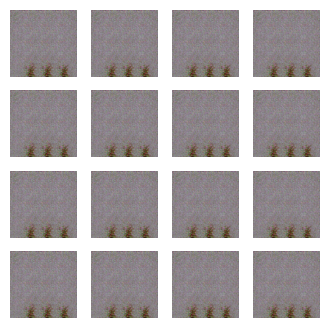

Time for epoch 109 is 2.1454079151153564 sec


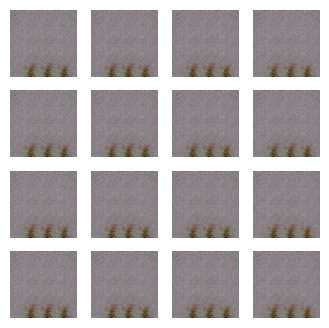

Time for epoch 110 is 2.49965238571167 sec


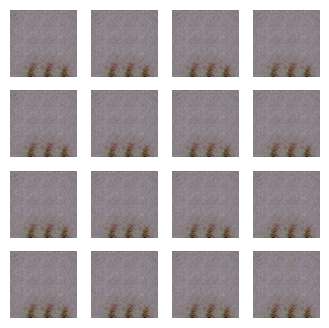

Time for epoch 111 is 2.2010622024536133 sec


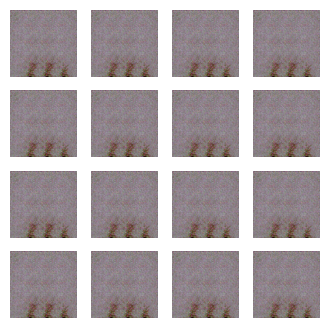

Time for epoch 112 is 2.197058916091919 sec


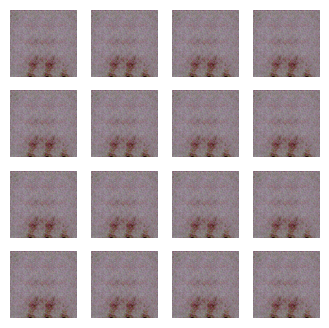

Time for epoch 113 is 2.192021131515503 sec


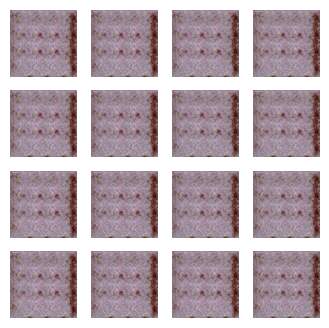

Time for epoch 114 is 2.1585986614227295 sec


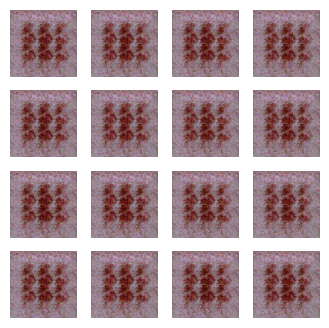

Time for epoch 115 is 2.4673781394958496 sec


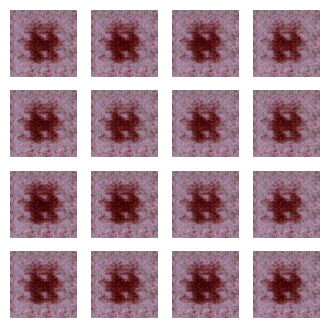

Time for epoch 116 is 2.2978029251098633 sec


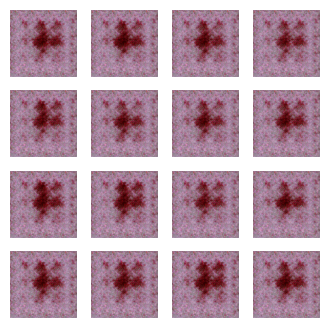

Time for epoch 117 is 2.215423583984375 sec


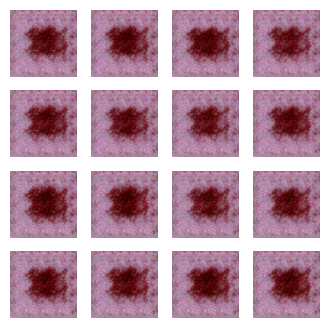

Time for epoch 118 is 2.1670258045196533 sec


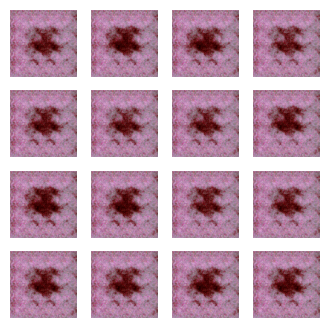

Time for epoch 119 is 2.153372287750244 sec


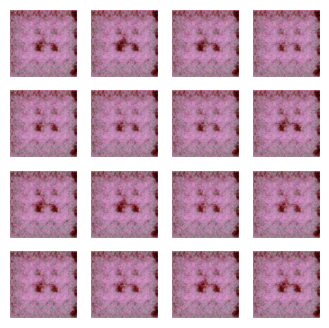

Time for epoch 120 is 2.5822503566741943 sec


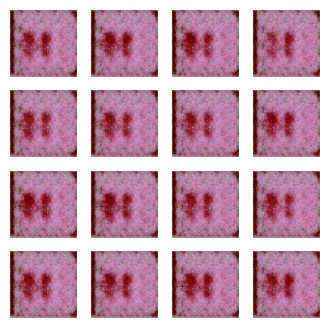

Time for epoch 121 is 2.180856466293335 sec


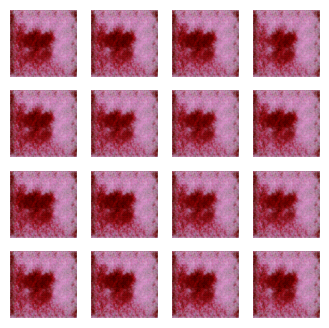

Time for epoch 122 is 2.269765853881836 sec


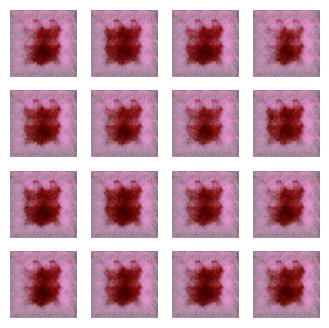

Time for epoch 123 is 2.1334123611450195 sec


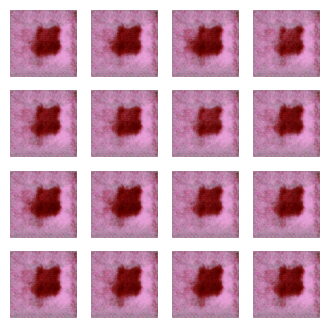

Time for epoch 124 is 2.2060019969940186 sec


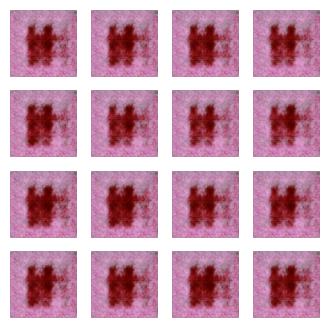

Time for epoch 125 is 2.5077972412109375 sec


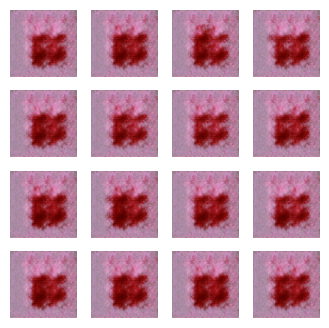

Time for epoch 126 is 2.152315378189087 sec


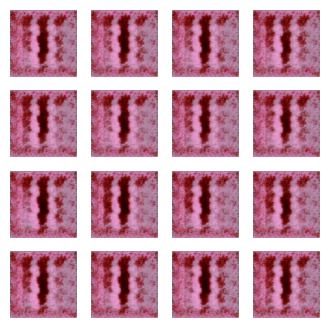

Time for epoch 127 is 2.159048318862915 sec


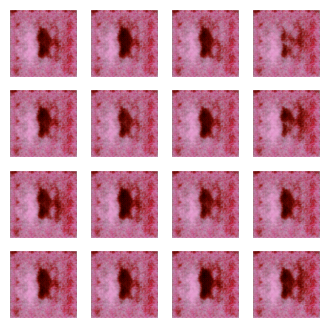

Time for epoch 128 is 2.2201309204101562 sec


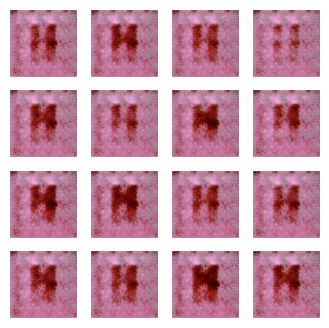

Time for epoch 129 is 2.150153160095215 sec


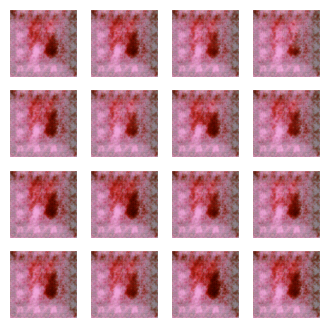

Time for epoch 130 is 2.498849391937256 sec


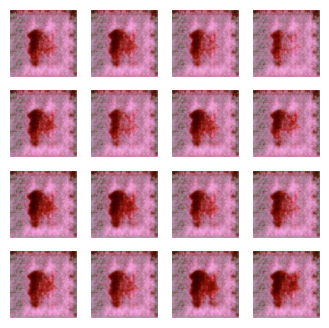

Time for epoch 131 is 2.2051024436950684 sec


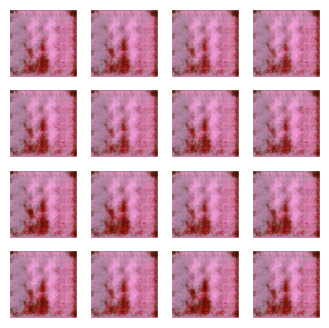

Time for epoch 132 is 2.1570498943328857 sec


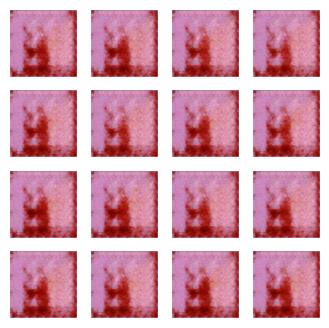

Time for epoch 133 is 2.4274256229400635 sec


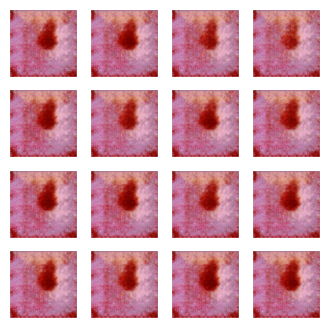

Time for epoch 134 is 2.192735433578491 sec


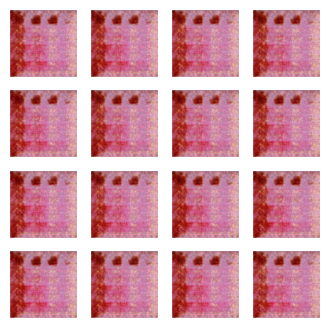

Time for epoch 135 is 2.414307117462158 sec


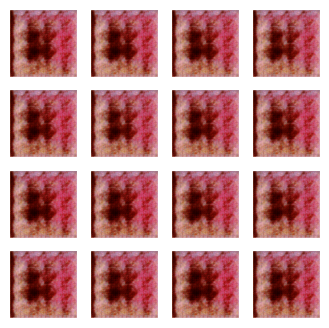

Time for epoch 136 is 2.1373820304870605 sec


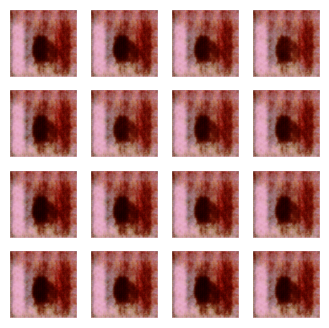

Time for epoch 137 is 2.1599249839782715 sec


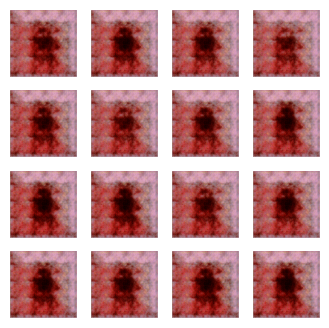

Time for epoch 138 is 2.2064406871795654 sec


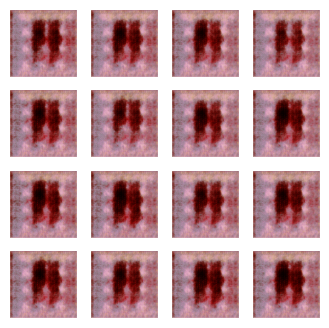

Time for epoch 139 is 2.214993953704834 sec


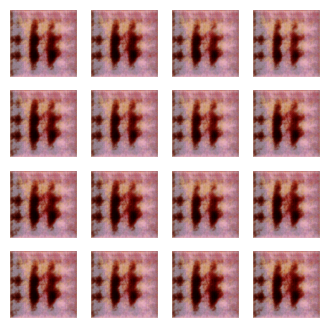

Time for epoch 140 is 2.51039981842041 sec


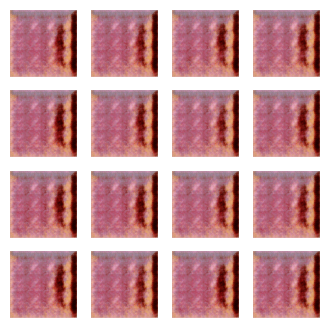

Time for epoch 141 is 2.1720547676086426 sec


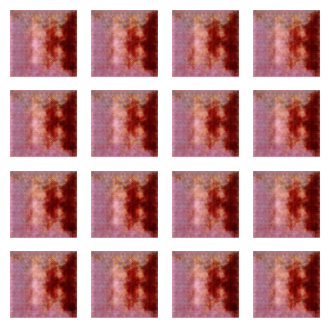

Time for epoch 142 is 2.1200461387634277 sec


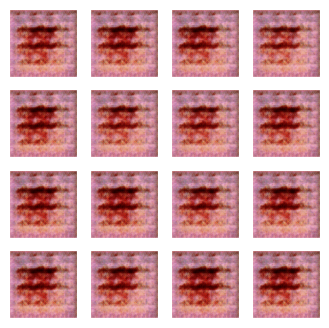

Time for epoch 143 is 2.1585750579833984 sec


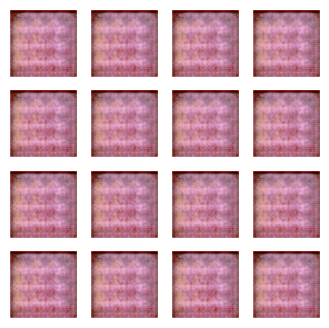

Time for epoch 144 is 2.2923312187194824 sec


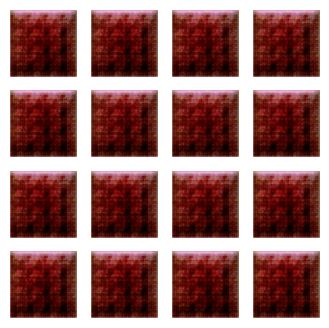

Time for epoch 145 is 2.5103812217712402 sec


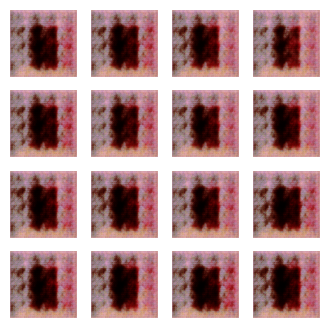

Time for epoch 146 is 2.1527438163757324 sec


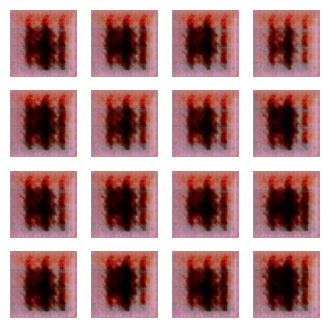

Time for epoch 147 is 2.10846209526062 sec


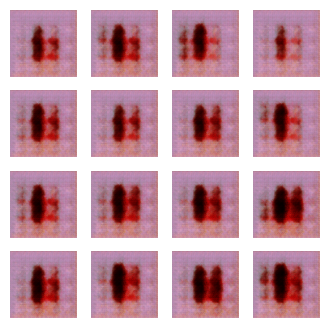

Time for epoch 148 is 2.167051076889038 sec


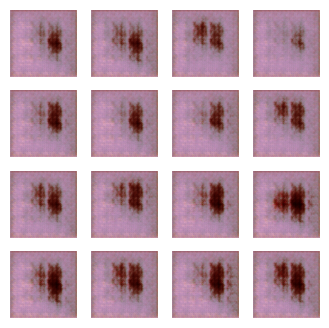

Time for epoch 149 is 2.1448912620544434 sec


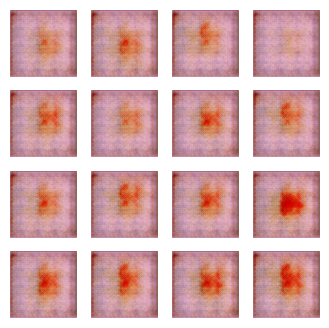

Time for epoch 150 is 2.491068124771118 sec


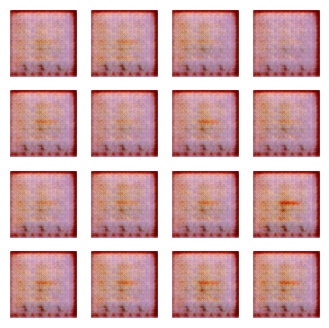

Time for epoch 151 is 2.1510391235351562 sec


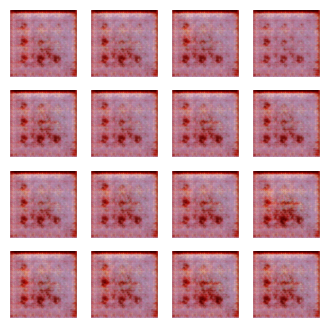

Time for epoch 152 is 2.1226961612701416 sec


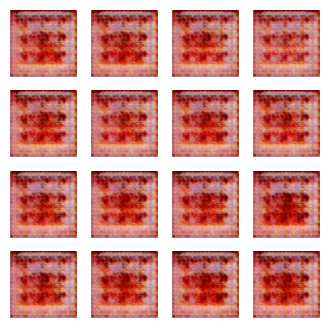

Time for epoch 153 is 2.1891286373138428 sec


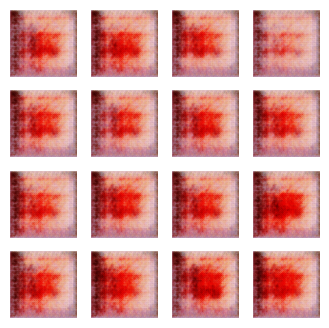

Time for epoch 154 is 2.16815447807312 sec


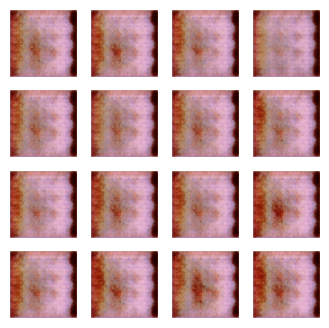

Time for epoch 155 is 2.503920555114746 sec


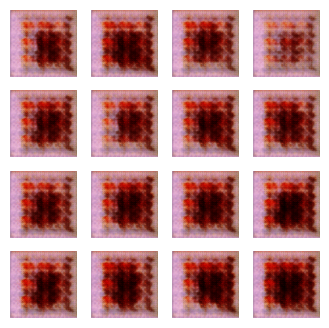

Time for epoch 156 is 2.1758415699005127 sec


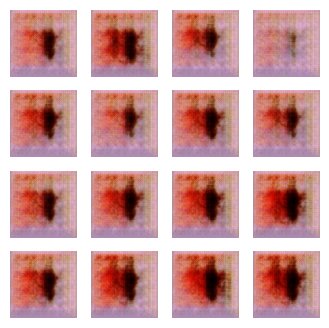

Time for epoch 157 is 2.1772966384887695 sec


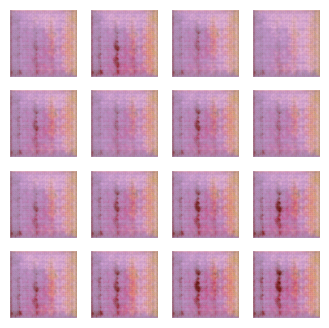

Time for epoch 158 is 2.142521858215332 sec


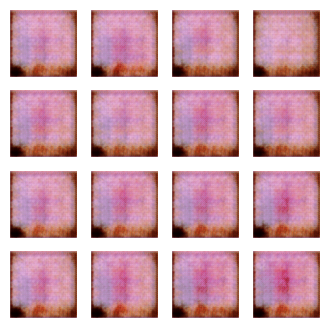

Time for epoch 159 is 2.194409132003784 sec


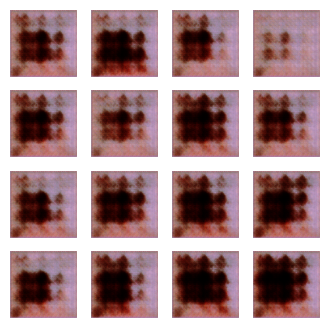

Time for epoch 160 is 2.5134005546569824 sec


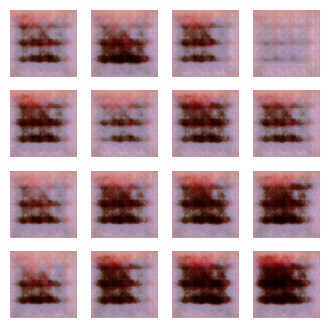

Time for epoch 161 is 2.2187769412994385 sec


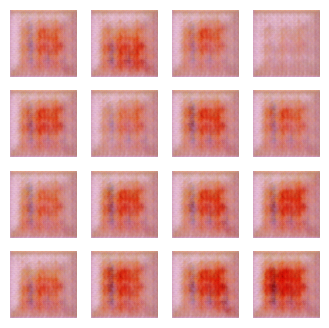

Time for epoch 162 is 2.153085231781006 sec


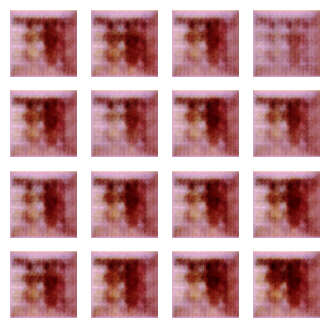

Time for epoch 163 is 2.1959071159362793 sec


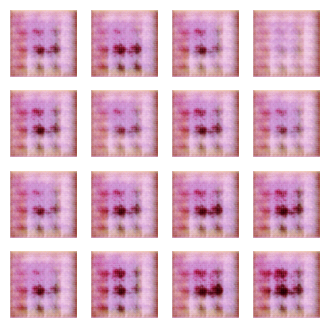

Time for epoch 164 is 2.1325864791870117 sec


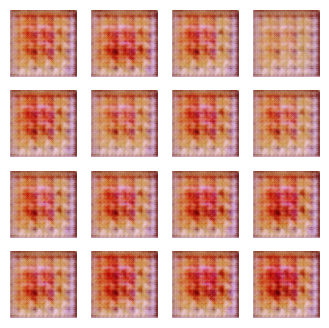

Time for epoch 165 is 2.4230637550354004 sec


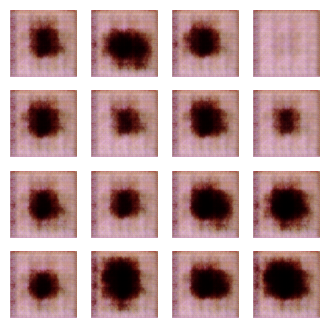

Time for epoch 166 is 2.125945806503296 sec


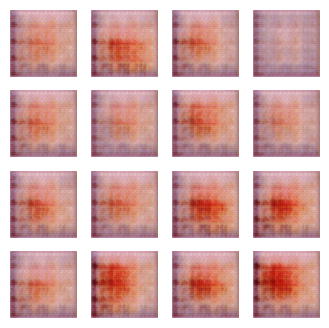

Time for epoch 167 is 2.2305028438568115 sec


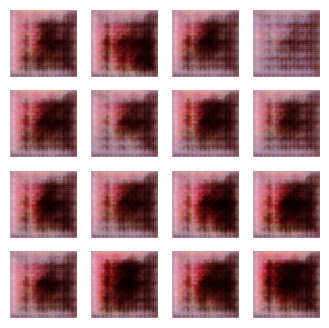

Time for epoch 168 is 2.152289867401123 sec


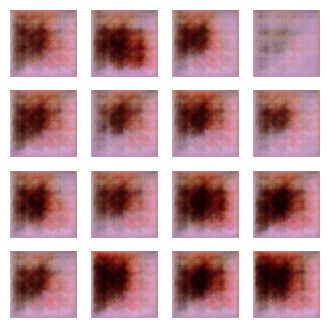

Time for epoch 169 is 2.4348881244659424 sec


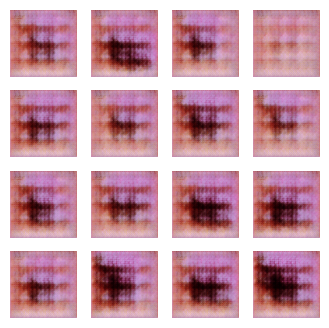

Time for epoch 170 is 2.168881893157959 sec


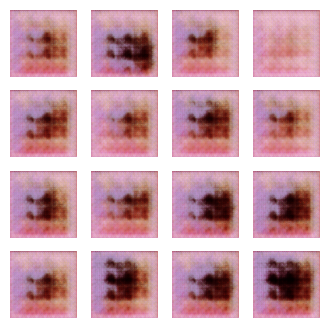

Time for epoch 171 is 2.1612296104431152 sec


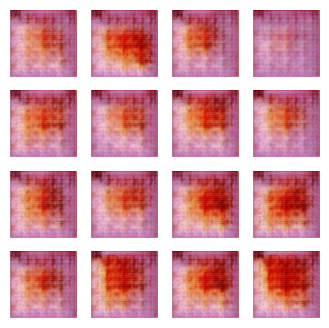

Time for epoch 172 is 2.2255752086639404 sec


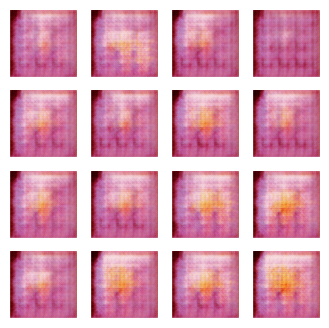

Time for epoch 173 is 2.181884288787842 sec


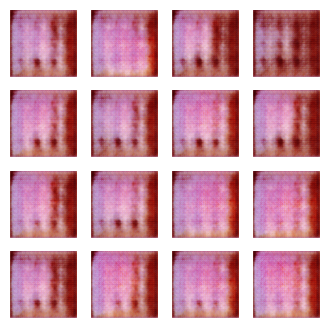

Time for epoch 174 is 2.1877357959747314 sec


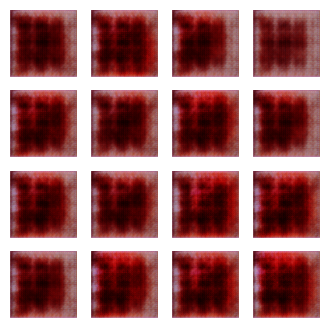

Time for epoch 175 is 2.4510891437530518 sec


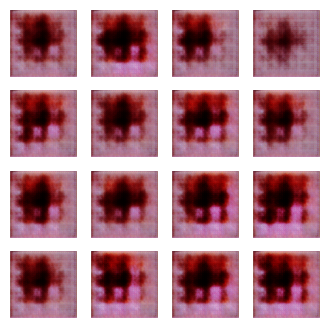

Time for epoch 176 is 2.170759439468384 sec


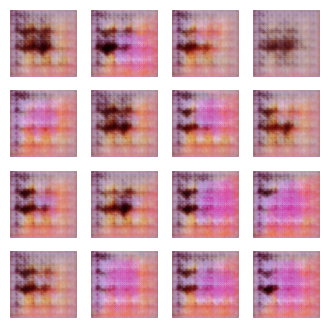

Time for epoch 177 is 2.2285847663879395 sec


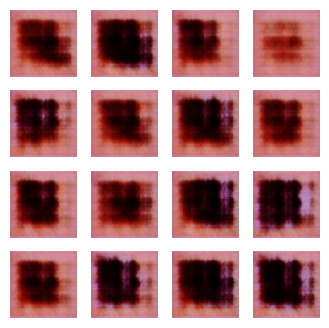

Time for epoch 178 is 2.1838245391845703 sec


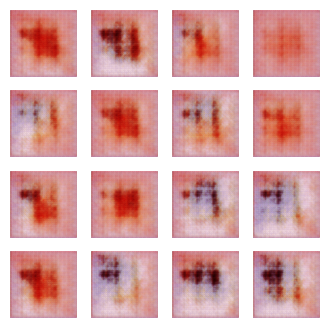

Time for epoch 179 is 2.447927713394165 sec


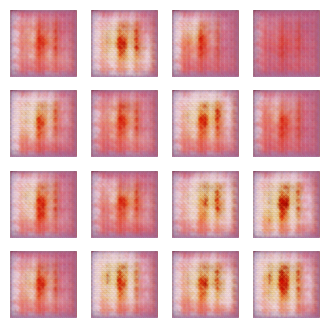

Time for epoch 180 is 2.204103946685791 sec


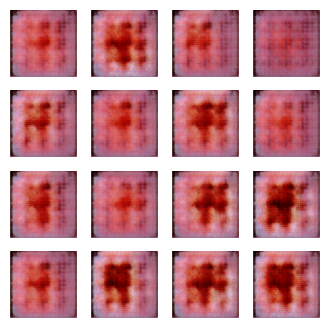

Time for epoch 181 is 2.1889560222625732 sec


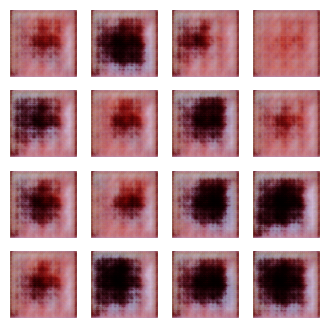

Time for epoch 182 is 2.1186656951904297 sec


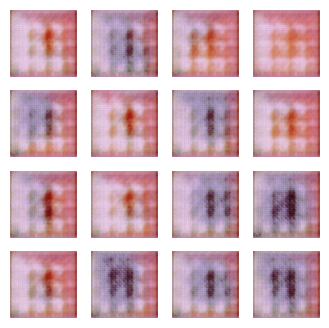

Time for epoch 183 is 2.2274675369262695 sec


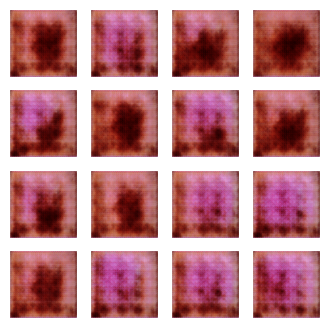

Time for epoch 184 is 2.498246669769287 sec


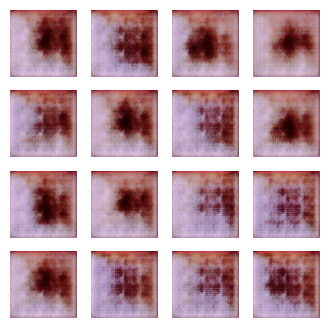

Time for epoch 185 is 2.165740489959717 sec


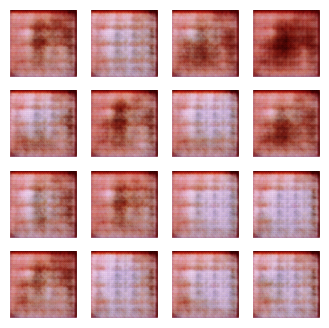

Time for epoch 186 is 2.2006354331970215 sec


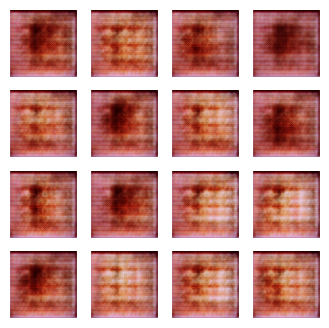

Time for epoch 187 is 2.111480951309204 sec


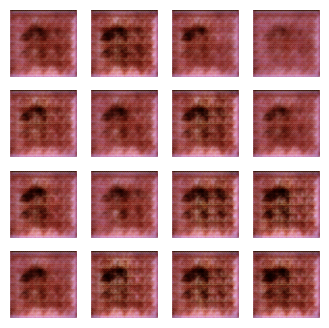

Time for epoch 188 is 2.128589630126953 sec


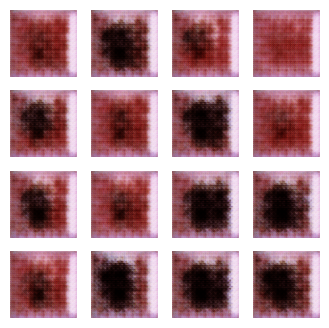

Time for epoch 189 is 2.711989641189575 sec


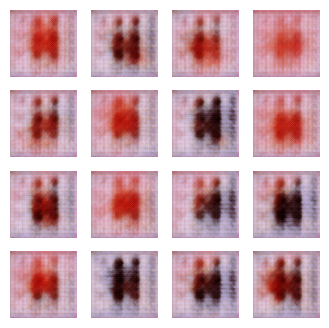

Time for epoch 190 is 2.199033260345459 sec


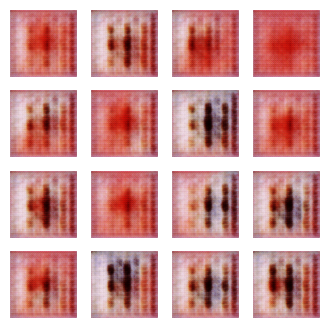

Time for epoch 191 is 2.113313674926758 sec


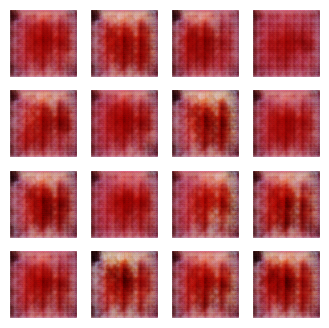

Time for epoch 192 is 2.148721933364868 sec


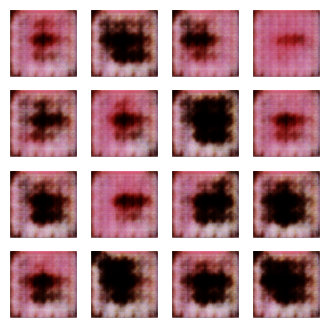

Time for epoch 193 is 2.1623995304107666 sec


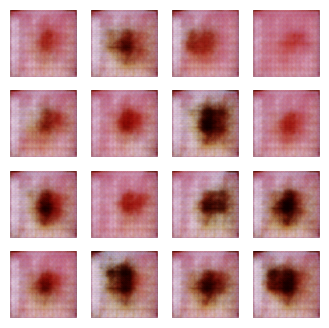

Time for epoch 194 is 2.560678720474243 sec


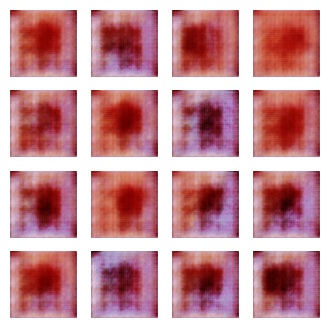

Time for epoch 195 is 2.215444564819336 sec


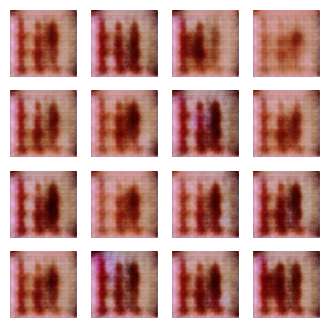

Time for epoch 196 is 2.2122621536254883 sec


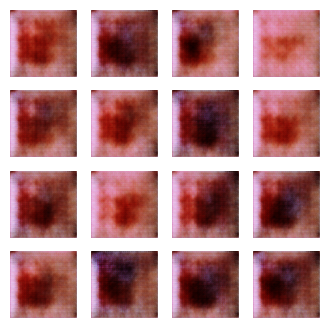

Time for epoch 197 is 2.2461094856262207 sec


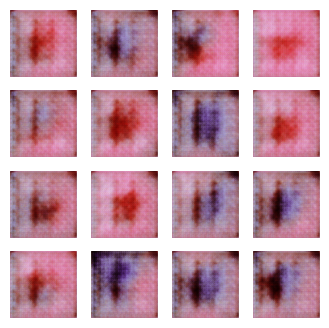

Time for epoch 198 is 2.1629393100738525 sec


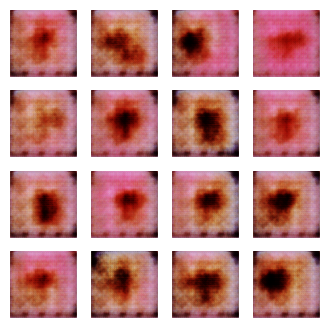

Time for epoch 199 is 2.518509864807129 sec


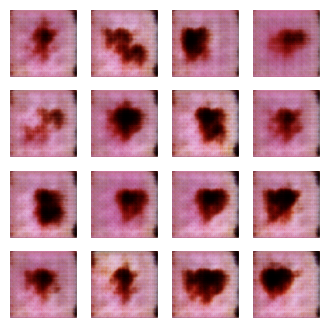

Time for epoch 200 is 2.2219550609588623 sec


In [47]:
#with tf.device('/GPU:0'):
train(melanomaTraining, epochs)
checkpoint.restore(tf.train.latest_checkpoint(checkpointDir))


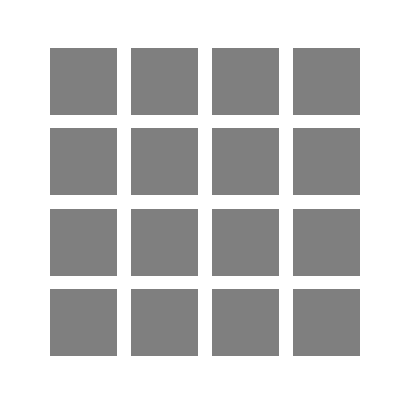

In [37]:
# Display a single image using the epoch number
def displayImg(epoch):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch))
displayImg(epochs)
animFile = 'dcgan.gif'

with imageio.get_writer(animFile, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.v2.imread(filename)
    writer.append_data(image)
  image = imageio.v2.imread(filename)
  writer.append_data(image)
embed.embed_file(animFile)

In [48]:
checkpoint.restore('training_checkpoints/ckpt-166')
checkpoint.generator.save('/content/gdrive/MyDrive/PUC/TCC/Notebooks/preTreinados/generatorV5.h5')

In [49]:
checkpoint.restore('training_checkpoints/ckpt-200')
checkpoint.generator.save('/content/gdrive/MyDrive/PUC/TCC/Notebooks/preTreinados/generatorV6.h5')